# **PROYECTO FINAL**
**CURSO INTRODUCCIÓN A PYTHON PARA CIENCIA DE DATOS**


**Participante:**
Mónica Retamosa Izaguirre


# **Introducción**

El pájaro campana (*Procnias tricarunculatus*)​ es una especie de ave paseriforme de la familia Cotingidae. Es nativo de América Central. Se distribuye por las tierras altas al este de Honduras, noroeste de Nicaragua, Costa Rica y Panamá. En los inviernos habita en las tierras bajas adyacentes. Es un migrante altitudinal que realiza migraciones complejas (Powell & Bjork, 2004). En la época reproductiva vive en los niveles alto y medio del bosque húmedo de montaña, entre los 1200 y 2100 m de altitud. Fuera de la época reproductiva puede ascender hasta los 3000 msnm y descender a las tierras bajas a 600 m de altitud (Brant et al. 2020).

Esta especie está catalogada por la lista roja de la
UICN como vulnerable, con su población total estimada entre 3600 y 14 000 individuos maduros, considerada en rápida decadencia debido a la pérdida de hábitat y su degradación (BirdLife International 2021). Por lo tanto, es importante conocer su distribuición y abundancia, para tomar decisiones de conservación bien informadas.

# **Objetivo del proyecto**

Analizar la distribución de la especie pájaro campana (*Procnias tricarunculatus*) en Costa Rica.



# **Métodología**

**1- Descarga de los datos del pájaro campana de GBIF**

**2- Depuración datos:**

*   Eliminación columnas que no aportan información
*   Identificación de datos faltantes
*   Identificación de  registros duplicados

**3- Análisis exploratorio de datos:**

*   Ocurrencia del pájaro campana por provincia de
     Costa Rica
*   Ocurrencia del pájaro campana en Costa Rica por
     año

**4.- Mapeo de distribución de la especie**

*   Descarga de datos de GADM
*   Clasificación de Costa Rica en provincias
*   Conversión de observaciones a puntos
*   Mapeo de observaciones sobre el mapa de provincias de Costa Rica





### **Aplicación de metodología y resultados**

**1.- Descarga de datos GBIF**


Procedencia de los datos:
Los datos de presencia del pájaro campana proceden de los registros almacenados en la plataforma del Fondo Mundial de Información sobre Biodiversidad
(GBIF.org, 2023)

**2.- Depuración de datos**

Importación de librerías y carga de datos

In [ ]:
# Importar librerías
!pip install pandas
!pip install ydata-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 359.5/359.5 kB 8.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 13.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 26.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 25.4 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=dec717f5ad23ee5b98f48735903afc56b79667365f782f26f2bbc583ed32ef93
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from ydata_profiling import ProfileReport

In [ ]:
# Importar datos como dataframe pandas
df = pd.read_csv('Ocurrencias_pajaro_campana_cr.csv', encoding='latin-1')

<ipython-input-14-05ad2ed9349a>:2: DtypeWarning: Columns (64,65,99,100,101,102,103,104,106,107,108,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,128,129,130,131,132,133,134,135,136,137,138,144) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('Ocurrencias_pajaro_campana_cr.csv', encoding='latin-1')


## **Limpieza y Depuración de datos**

In [ ]:
df.columns

Index(['wkt_geom', 'wkt_geom.1', 'fid', 'key', 'datasetKey', 'publishing',
       'installati', 'publishi_1', 'protocol', 'lastCrawle',
       ...
       'higherGe_1', 'locationID', 'associated', 'elevation', 'elevationA',
       'depth', 'depthAccur', 'organismQu', 'organism_1', 'Provincia'],
      dtype='object', length=146)

In [ ]:
nombre = "Observaciones pájaro campana en Costa Rica"
profile = ProfileReport(df, title=nombre, explorative=True)

# Mostrar el informe en un notebook (si estás usando Jupyter o similares)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_file("pájaro_campana_Costa Rica.html")

/usr/local/lib/python3.10/dist-packages/ydata_profiling/profile_report.py:363: UserWarning: Try running command: 'pip install --upgrade Pillow' to avoid ValueError
  warnings.warn(


Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

De acuerdo con el screening en panda profiling existen 146 variables y 9540 observaciones del pájaro campana en Costa Rica. No parece haber ningún dato duplicado. Debido a que existen muchas columnas sin datos, se prodecerá a seleccionar aquellas que parecen más relevantes para el análisis y no tienen datos faltantes.

In [ ]:
# Hacer una lista con el nombre de las columnas seleccionadas y seleccionar en 1 nuevo dataframe
headers = [
    "wkt_geom" , "fid", "taxonKey", "kingdomKey", "phylumKey", "classKey", "orderKey", "familyKey", "genusKey", "speciesKey", "acceptedSc", "kingdom", "phylum", "order", "family", "genus", "species", "genericNam", "specificEp", "iucnRedLis", "decimalLon", "decimalLat", "year", "month", "day", "eventDate", "geodeticDa", "class", "countryCod", "country", "gbifID", "Provincia"
    ] # Added a comma between "species" and "genericNam"
df_seleccion = df[headers]


#Comprobar número columans y número datos antes selección
print("Antes: ", df.shape)

df = df_seleccion
print("Después: ", df.shape)

Antes:  (9540, 146)
Después:  (9540, 32)


In [ ]:
#Provincia denota la máxima división de Costa Rica. Son 7 provincias y aparecen correctamente en el dataframe-
df["Provincia"].describe()

count           9540
unique             7
top       Puntarenas
freq            6357
Name: Provincia, dtype: object

In [ ]:
df["Provincia"].unique()

array(['Puntarenas', 'Alajuela', 'Guanacaste', 'San Jose', 'Cartago',
       'Heredia', 'Limon'], dtype=object)

In [ ]:
#Hacer un dataframe con los datos correspondientes a las provincias de Costa Rica
provcr = ['Puntarenas', 'Alajuela', 'Guanacaste', 'San Jose',
        'Cartago', 'Heredia', 'Limon',
       ]
condition = df["Provincia"].isin(provcr)
provcr_df = df[condition]
provcr_df

,wkt_geom,fid,taxonKey,kingdomKey,phylumKey,classKey,orderKey,familyKey,genusKey,speciesKey,...,year,month,day,eventDate,geodeticDa,class,countryCod,country,gbifID,Provincia
0,Point (-85.03195999999999799 10.13682000000000...,1,2486403,1,44,212,729,5236,2486399,2486403,...,2022,1,12,00:00.0,WGS84,Aves,CR,Costa Rica,3723630827,Puntarenas
1,Point (-85.03496599999999717 10.13837900000000...,2,2486403,1,44,212,729,5236,2486399,2486403,...,2022,1,12,00:00.0,WGS84,Aves,CR,Costa Rica,3823317640,Puntarenas
2,Point (-84.70702300000000662 10.2787860000000002),4,2486403,1,44,212,729,5236,2486399,2486403,...,2022,2,22,34:16.0,WGS84,Aves,CR,Costa Rica,3698152786,Alajuela
3,Point (-84.6213860000000011 10.34524099999999969),5,2486403,1,44,212,729,5236,2486399,2486403,...,2022,3,19,35:05.0,WGS84,Aves,CR,Costa Rica,3746965687,Alajuela
4,Point (-84.83890399999999943 10.26908300000000...,6,2486403,1,44,212,729,5236,2486399,2486403,...,2022,3,16,00:00.0,WGS84,Aves,CR,Costa Rica,3747035901,Puntarenas
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9535,Point (-84.07390999999999792 10.27356299999999...,9562,2486403,1,44,212,729,5236,2486399,2486403,...,0,0,0,NaN,WGS84,Aves,CR,Costa Rica,858398645,Heredia
9536,Point (-84.15439999999999543 9.7468009999999996),9563,2486403,1,44,212,729,5236,2486399,2486403,...,0,0,0,NaN,WGS84,Aves,CR,Costa Rica,2804112890,San Jose
9537,Point (-84.81565500000000668 10.30951499999999...,9564,2486403,1,44,212,729,5236,2486399,2486403,...,0,0,0,NaN,WGS84,Aves,CR,Costa Rica,70356581,Puntarenas
9538,Point (-83.29999999999999716 10),9565,2486403,1,44,212,729,5236,2486399,2486403,...,0,0,0,NaN,WGS84,Aves,CR,Costa Rica,2434045782,Limon


In [ ]:
df = provcr_df

In [ ]:
df["iucnRedLis"].describe()

count     9540
unique       1
top         VU
freq      9540
Name: iucnRedLis, dtype: object

In [ ]:
df["iucnRedLis"].unique()

array(['VU'], dtype=object)

In [ ]:
# Información sobre tipos de datos y valores no nulos
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9540 entries, 0 to 9539
Data columns (total 32 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   wkt_geom    9540 non-null   object 
 1   fid         9540 non-null   int64  
 2   taxonKey    9540 non-null   int64  
 3   kingdomKey  9540 non-null   int64  
 4   phylumKey   9540 non-null   int64  
 5   classKey    9540 non-null   int64  
 6   orderKey    9540 non-null   int64  
 7   familyKey   9540 non-null   int64  
 8   genusKey    9540 non-null   int64  
 9   speciesKey  9540 non-null   int64  
 10  acceptedSc  9540 non-null   object 
 11  kingdom     9540 non-null   object 
 12  phylum      9540 non-null   object 
 13  order       9540 non-null   object 
 14  family      9540 non-null   object 
 15  genus       9540 non-null   object 
 16  species     9540 non-null   object 
 17  genericNam  9540 non-null   object 
 18  specificEp  9540 non-null   object 
 19  iucnRedLis  9540 non-null  

In [ ]:
# Encontrar duplicados, considerando todas las columnas
duplicates = df.duplicated(keep=False)  # keep=False marca todos los duplicados
print("\nFilas duplicadas:")
df[duplicates]


Filas duplicadas:


,wkt_geom,fid,taxonKey,kingdomKey,phylumKey,classKey,orderKey,familyKey,genusKey,speciesKey,...,year,month,day,eventDate,geodeticDa,class,countryCod,country,gbifID,Provincia


# **Análisis Exploratorio de Datos (EDA) con gráficas**

**Ocurrencia del pájaro campana por provincia de Costa Rica**

In [ ]:
# Contar las ocurrencias del pájaro campana en la columna 'Provincia'
order_counts = df['Provincia'].value_counts()
order_counts

Provincia
Puntarenas    6357
Alajuela      1481
Guanacaste    1263
Heredia        158
San Jose       115
Cartago        111
Limon           55
Name: count, dtype: int64

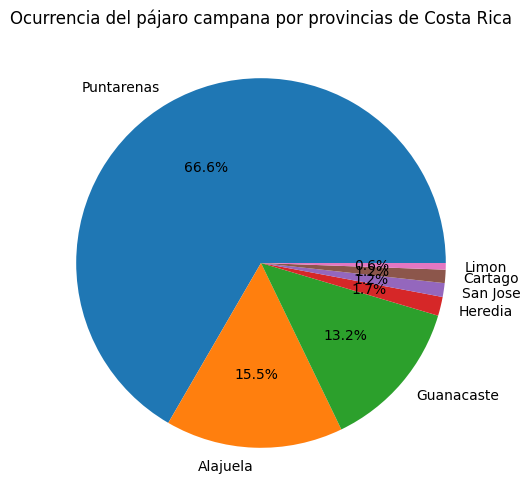

In [ ]:
# Graficar las ocurrencias del pájaro campana en la columna 'Provincia'
provincia_counts = df['Provincia'].value_counts()
provincia_counts

# Tamaño del gráfico
plt.figure(figsize=(6, 6))

# Crear la gráfica de pastel
plt.pie(provincia_counts, labels=provincia_counts.index, autopct='%1.1f%%')

# Título del gráfico
plt.title('Ocurrencia del pájaro campana por provincias de Costa Rica')

plt.show()

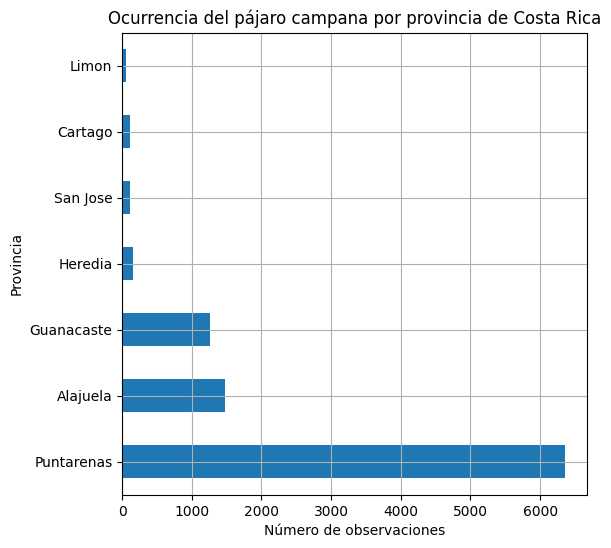

In [ ]:
# Misma información del gráfico anterior, pero usando otro tipo de gráfico
# Tamaño del gráfico
plt.figure(figsize=(6, 6))

# Agrupar datos por orden y obtener el número total de observaciones
provincia_counts = df.groupby('Provincia')['gbifID'].nunique()

# Crear gráfico de barras
# sepal_mean.plot(kind='bar')
order_counts.plot(kind='barh')

# Título del gráfico
plt.title('Ocurrencia del pájaro campana por provincia de Costa Rica')

# Etiqueta del eje Y
plt.ylabel('Provincia')

# Etiqueta del eje X
plt.xlabel('Número de observaciones')
plt.grid()
plt.show()

**Ocurrencia del pájaro campana en Costa Rica por año**

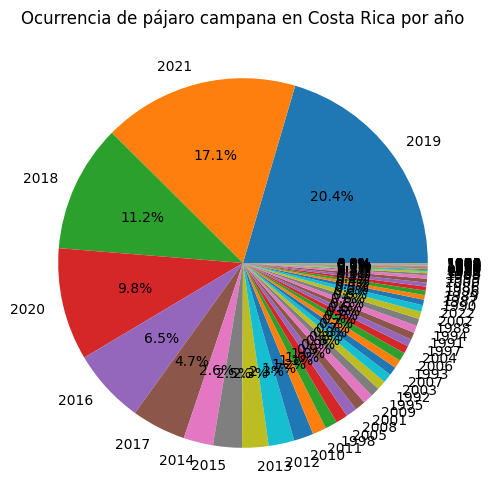

In [ ]:
# Número de observaciones de pájaro campana en Costa Rica por año
# Contar las ocurrencias de cada valor único en la columna 'año'
year_counts = df['year'].value_counts()
year_counts

# Tamaño del gráfico
plt.figure(figsize=(6, 6))

# Crear la gráfica de pastel
plt.pie(year_counts, labels= year_counts.index, autopct='%1.1f%%')

# Título del gráfico
plt.title('Ocurrencia de pájaro campana en Costa Rica por año')

plt.show()

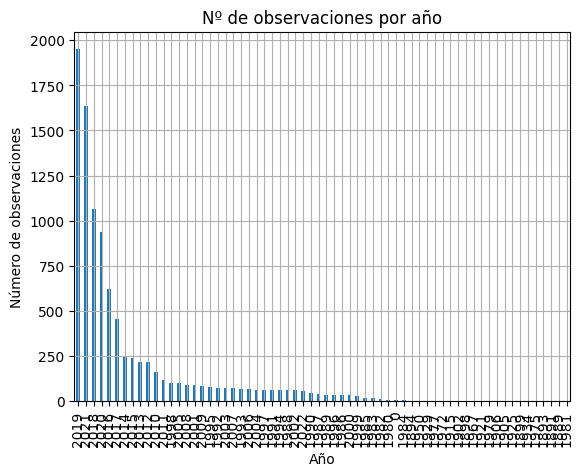

In [ ]:
# Crear gráfico de barras
year_counts.plot(kind='bar')

# Título del gráfico
plt.title('Nº de observaciones por año')

# Etiqueta del eje Y
plt.ylabel('Número de observaciones')

# Etiqueta del eje X
plt.xlabel('Año')
plt.grid()
plt.show()

In [ ]:
year_agrupado = df.groupby('year')
year_agrupado['gbifID'].count()

year
0          7
1889       1
1891       1
1893       1
1894       4
        ... 
2018    1065
2019    1950
2020     938
2021    1633
2022      57
Name: gbifID, Length: 64, dtype: int64

# **Mapeo de distribución de la especie**

In [ ]:
# Importar geopandas y geodatasets
!pip install geodatasets
import geopandas as gpd
import geodatasets
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

Los datos geográficos de Costa Rica fueron bajados de la página GADM

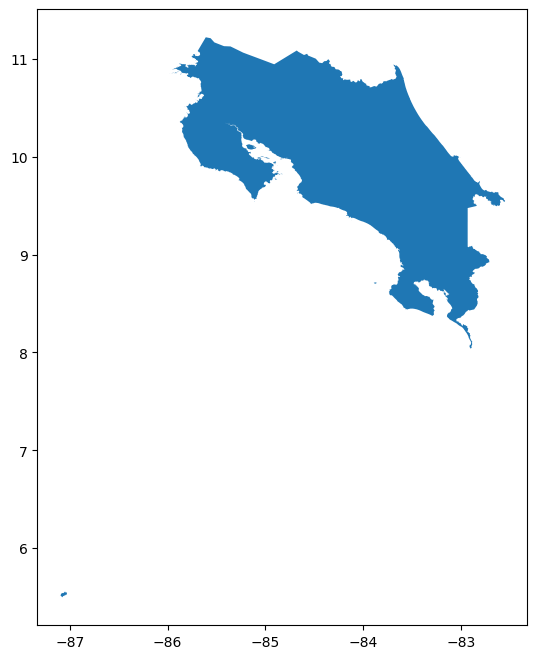

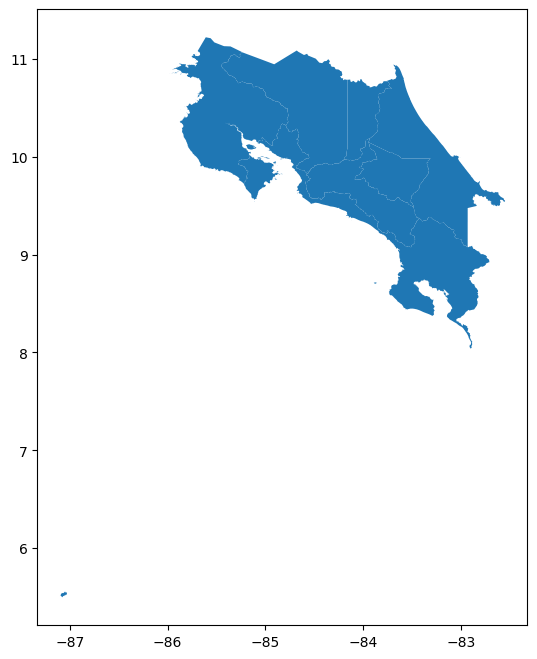

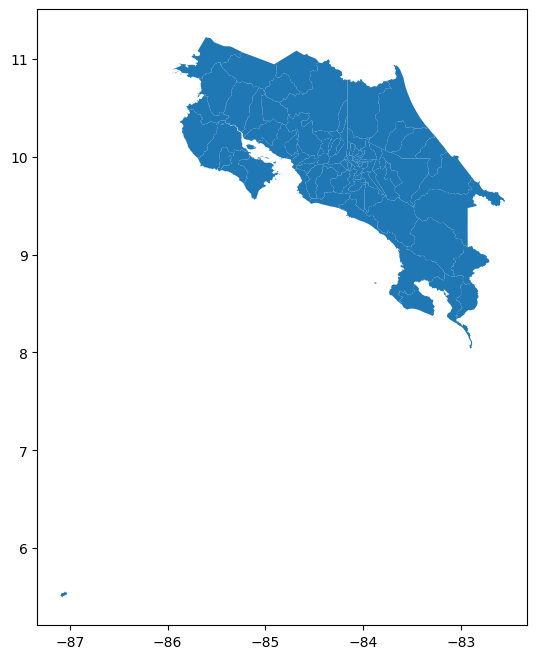

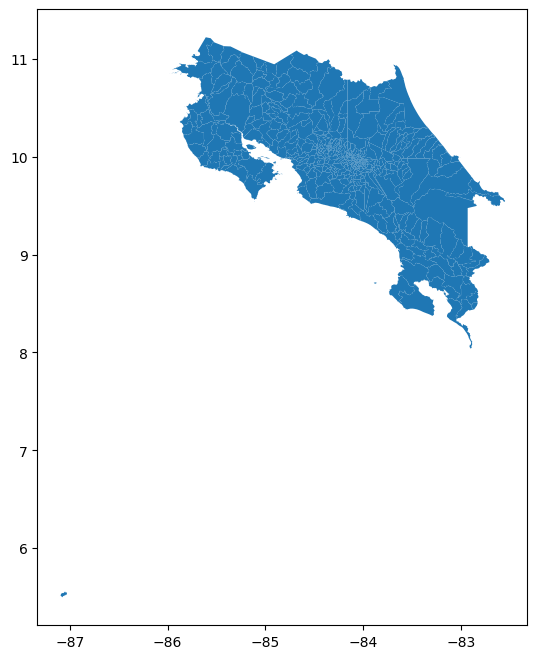

In [ ]:
gdfs=[]
for i in range(4):
    gdf = gpd.read_file(f'gadm41_CRI_{i}.shp')
    gdf.plot( figsize = (10, 8))
    gdfs.append(gdf)

In [ ]:
cr_mapa = gdfs[1]
cr_mapa

,geometry
0,"POLYGON ((-84.17403 10.00515, -84.17407 10.005..."
1,"POLYGON ((-83.54795 9.98187, -83.53987 9.98185..."
2,"MULTIPOLYGON (((-85.51540 9.86213, -85.51538 9..."
3,"POLYGON ((-84.10969 9.96130, -84.10998 9.96106..."
4,"MULTIPOLYGON (((-82.88183 9.56367, -82.88130 9..."
5,"MULTIPOLYGON (((-87.06868 5.50380, -87.06871 5..."
6,"POLYGON ((-83.50376 9.08283, -83.50415 9.08286..."


<Axes: >

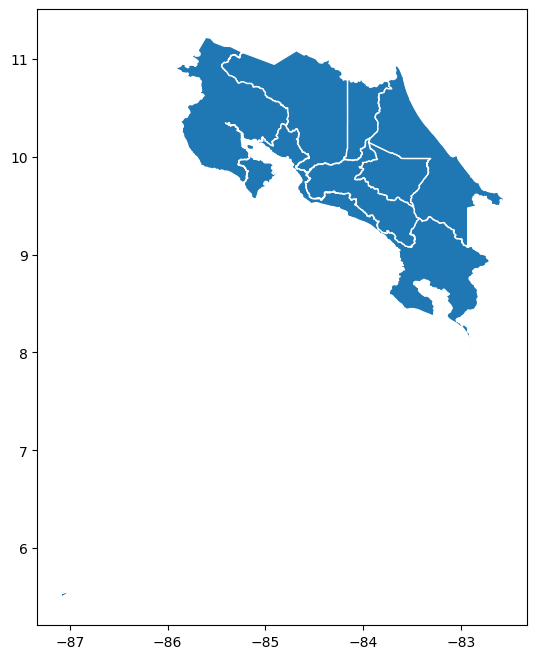

In [ ]:
cr_mapa.plot(figsize = (8,8), edgecolor="white")

In [ ]:
# Clasificación del mapa por provincias

# Obtener el área por provincia
cr_mapa["area"] = cr_mapa.area

# Obtener el límite opor provincia
cr_mapa["boundary"] = cr_mapa.boundary

# Obtener el punto central por provincia
cr_mapa["centroid"] = cr_mapa.centroid

#cr_mapa.sort_values(["area"])
cr_mapa

,geometry,area,boundary,centroid
0,"POLYGON ((-84.17403 10.00515, -84.17407 10.005...",0.807384,"LINESTRING (-84.17403 10.00515, -84.17407 10.0...",POINT (-84.61412 10.56565)
1,"POLYGON ((-83.54795 9.98187, -83.53987 9.98185...",0.254953,"LINESTRING (-83.54795 9.98187, -83.53987 9.981...",POINT (-83.68327 9.81603)
2,"MULTIPOLYGON (((-85.51540 9.86213, -85.51538 9...",0.840827,"MULTILINESTRING ((-85.51540 9.86213, -85.51538...",POINT (-85.39182 10.44659)
3,"POLYGON ((-84.10969 9.96130, -84.10998 9.96106...",0.219884,"LINESTRING (-84.10969 9.96130, -84.10998 9.961...",POINT (-84.01300 10.42136)
4,"MULTIPOLYGON (((-82.88183 9.56367, -82.88130 9...",0.758580,"MULTILINESTRING ((-82.88183 9.56367, -82.88130...",POINT (-83.34399 9.94528)
5,"MULTIPOLYGON (((-87.06868 5.50380, -87.06871 5...",0.929214,"MULTILINESTRING ((-87.06868 5.50380, -87.06871...",POINT (-83.71909 9.14926)
6,"POLYGON ((-83.50376 9.08283, -83.50415 9.08286...",0.409255,"LINESTRING (-83.50376 9.08283, -83.50415 9.082...",POINT (-83.99178 9.60541)


In [ ]:
# Importar modulo
from geopy.geocoders import Nominatim


def get_prov(p):
    global geolocator

    # Obtener localización con geocode
    location = geolocator.geocode(f"{p.y}, {p.x}")
    return location[0].split(",")[-3][11:]


# Inicializar Nominatim API
geolocator = Nominatim(user_agent="geoPandas")

cr_mapa["provincia"] = cr_mapa.centroid.map(lambda p: get_prov(p))
cr_mapa

,geometry,area,boundary,centroid,provincia
0,"POLYGON ((-84.17403 10.00515, -84.17407 10.005...",0.807384,"LINESTRING (-84.17403 10.00515, -84.17407 10.0...",POINT (-84.61412 10.56565),Alajuela
1,"POLYGON ((-83.54795 9.98187, -83.53987 9.98185...",0.254953,"LINESTRING (-83.54795 9.98187, -83.53987 9.981...",POINT (-83.68327 9.81603),Cartago
2,"MULTIPOLYGON (((-85.51540 9.86213, -85.51538 9...",0.840827,"MULTILINESTRING ((-85.51540 9.86213, -85.51538...",POINT (-85.39182 10.44659),Guanacaste
3,"POLYGON ((-84.10969 9.96130, -84.10998 9.96106...",0.219884,"LINESTRING (-84.10969 9.96130, -84.10998 9.961...",POINT (-84.01300 10.42136),Heredia
4,"MULTIPOLYGON (((-82.88183 9.56367, -82.88130 9...",0.758580,"MULTILINESTRING ((-82.88183 9.56367, -82.88130...",POINT (-83.34399 9.94528),Cartago
5,"MULTIPOLYGON (((-87.06868 5.50380, -87.06871 5...",0.929214,"MULTILINESTRING ((-87.06868 5.50380, -87.06871...",POINT (-83.71909 9.14926),Puntarenas
6,"POLYGON ((-83.50376 9.08283, -83.50415 9.08286...",0.409255,"LINESTRING (-83.50376 9.08283, -83.50415 9.082...",POINT (-83.99178 9.60541),San José


<Axes: >

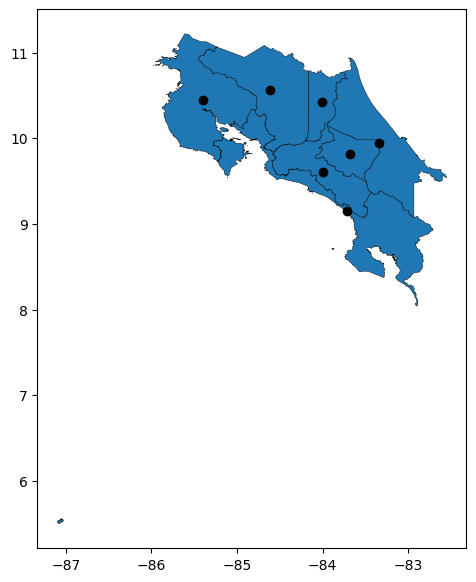

In [ ]:
# Graficar el centroide de cada provincia
cr_mapa.set_geometry("centroid")
axes = cr_mapa["geometry"].plot(edgecolor="black", linewidth=0.3, figsize=(7, 7))
cr_mapa["centroid"].plot(ax=axes, color="black")

In [ ]:
# Nombrar las provincias en el DF de acuerdo al centroide y área
cr_mapa.loc[4, ("provincia")] = "Limón"
cr_mapa

,geometry,area,boundary,centroid,provincia
0,"POLYGON ((-84.17403 10.00515, -84.17407 10.005...",0.807384,"LINESTRING (-84.17403 10.00515, -84.17407 10.0...",POINT (-84.61412 10.56565),Alajuela
1,"POLYGON ((-83.54795 9.98187, -83.53987 9.98185...",0.254953,"LINESTRING (-83.54795 9.98187, -83.53987 9.981...",POINT (-83.68327 9.81603),Cartago
2,"MULTIPOLYGON (((-85.51540 9.86213, -85.51538 9...",0.840827,"MULTILINESTRING ((-85.51540 9.86213, -85.51538...",POINT (-85.39182 10.44659),Guanacaste
3,"POLYGON ((-84.10969 9.96130, -84.10998 9.96106...",0.219884,"LINESTRING (-84.10969 9.96130, -84.10998 9.961...",POINT (-84.01300 10.42136),Heredia
4,"MULTIPOLYGON (((-82.88183 9.56367, -82.88130 9...",0.758580,"MULTILINESTRING ((-82.88183 9.56367, -82.88130...",POINT (-83.34399 9.94528),Limón
5,"MULTIPOLYGON (((-87.06868 5.50380, -87.06871 5...",0.929214,"MULTILINESTRING ((-87.06868 5.50380, -87.06871...",POINT (-83.71909 9.14926),Puntarenas
6,"POLYGON ((-83.50376 9.08283, -83.50415 9.08286...",0.409255,"LINESTRING (-83.50376 9.08283, -83.50415 9.082...",POINT (-83.99178 9.60541),San José


<Axes: >

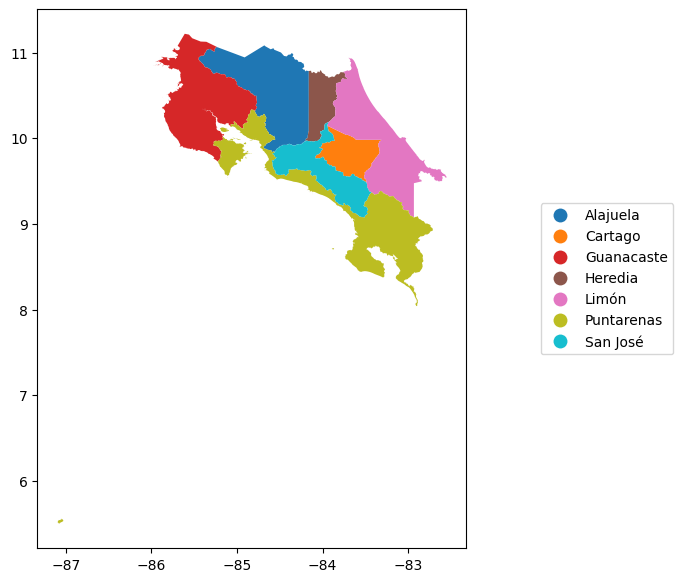

In [ ]:
#Graficar las provincias con su respectivo nombre
cr_mapa.plot(column="provincia",
            legend=True,
            legend_kwds={"loc": "center right", "bbox_to_anchor": (1.5, .50)},
            figsize=(7, 7)
           )

In [ ]:
# Introducir coordenadas de registros de especies
observaciones = pd.read_csv("Ocurrencias_pajaro_campana_cr.csv", encoding='latin-1')
observaciones.head()

<ipython-input-71-dd76e02bcee4>:2: DtypeWarning: Columns (64,65,99,100,101,102,103,104,106,107,108,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,128,129,130,131,132,133,134,135,136,137,138,144) have mixed types. Specify dtype option on import or set low_memory=False.
  observaciones = pd.read_csv("Ocurrencias_pajaro_campana_cr.csv", encoding='latin-1')


,wkt_geom,wkt_geom.1,fid,key,datasetKey,publishing,installati,publishi_1,protocol,lastCrawle,...,higherGe_1,locationID,associated,elevation,elevationA,depth,depthAccur,organismQu,organism_1,Provincia
0,Point (-85.03195999999999799 10.13682000000000...,Point (-85.03196000000453125 10.13681999999888...,1,3723630827,8a863029-f435-446a-821e-275f4f641165,c8d737e0-2ff8-42e8-b8fc-6b805d26fc5f,85ccfd1a-a837-48d6-9a87-96c99f6fe012,NL,DWC_ARCHIVE,53:35.2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,Puntarenas
1,Point (-85.03496599999999717 10.13837900000000...,Point (-85.03496600000454464 10.13837899999889...,2,3823317640,8a863029-f435-446a-821e-275f4f641165,c8d737e0-2ff8-42e8-b8fc-6b805d26fc5f,85ccfd1a-a837-48d6-9a87-96c99f6fe012,NL,DWC_ARCHIVE,53:35.2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,Puntarenas
2,Point (-84.70702300000000662 10.2787860000000002),Point (-84.70702300000432672 10.27878599999898...,4,3698152786,50c9509d-22c7-4a22-a47d-8c48425ef4a7,28eb1a3f-1c15-4a95-931a-4af90ecb574d,997448a8-f762-11e1-a439-00145eb45e9a,US,DWC_ARCHIVE,32:53.9,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,Alajuela
3,Point (-84.6213860000000011 10.34524099999999969),Point (-84.62138600000426436 10.3452409999990369),5,3746965687,50c9509d-22c7-4a22-a47d-8c48425ef4a7,28eb1a3f-1c15-4a95-931a-4af90ecb574d,997448a8-f762-11e1-a439-00145eb45e9a,US,DWC_ARCHIVE,32:53.9,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,Alajuela
4,Point (-84.83890399999999943 10.26908300000000...,Point (-84.83890400000440479 10.26908299999897...,6,3747035901,50c9509d-22c7-4a22-a47d-8c48425ef4a7,28eb1a3f-1c15-4a95-931a-4af90ecb574d,997448a8-f762-11e1-a439-00145eb45e9a,US,DWC_ARCHIVE,32:53.9,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,Puntarenas


In [ ]:
observaciones.columns

Index(['wkt_geom', 'wkt_geom.1', 'fid', 'key', 'datasetKey', 'publishing',
       'installati', 'publishi_1', 'protocol', 'lastCrawle',
       ...
       'higherGe_1', 'locationID', 'associated', 'elevation', 'elevationA',
       'depth', 'depthAccur', 'organismQu', 'organism_1', 'Provincia'],
      dtype='object', length=146)

In [ ]:
# Convertir las coordenadas a puntos
obvs_points = gpd.points_from_xy(observaciones.decimalLon, observaciones.decimalLat)
obvs_points

<GeometryArray>
[<POINT (-85.032 10.137)>, <POINT (-85.035 10.138)>, <POINT (-84.707 10.279)>,
 <POINT (-84.621 10.345)>, <POINT (-84.839 10.269)>, <POINT (-84.698 10.328)>,
  <POINT (-84.96 10.359)>, <POINT (-84.972 10.339)>, <POINT (-84.817 10.311)>,
  <POINT (-84.973 10.23)>,
 ...
   <POINT (-83.96 9.776)>,  <POINT (-83.833 9.983)>,  <POINT (-82.756 9.628)>,
 <POINT (-84.183 10.265)>,  <POINT (-84.253 9.625)>, <POINT (-84.074 10.274)>,
  <POINT (-84.154 9.747)>,  <POINT (-84.816 10.31)>,       <POINT (-83.3 10)>,
       <POINT (-83.3 10)>]
Length: 9540, dtype: geometry

In [ ]:
obvs_gdf = gpd.GeoDataFrame(observaciones, geometry=obvs_points)
obvs_gdf.head()

,wkt_geom,wkt_geom.1,fid,key,datasetKey,publishing,installati,publishi_1,protocol,lastCrawle,...,locationID,associated,elevation,elevationA,depth,depthAccur,organismQu,organism_1,Provincia,geometry
0,Point (-85.03195999999999799 10.13682000000000...,Point (-85.03196000000453125 10.13681999999888...,1,3723630827,8a863029-f435-446a-821e-275f4f641165,c8d737e0-2ff8-42e8-b8fc-6b805d26fc5f,85ccfd1a-a837-48d6-9a87-96c99f6fe012,NL,DWC_ARCHIVE,53:35.2,...,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,Puntarenas,POINT (-85.03196 10.13682)
1,Point (-85.03496599999999717 10.13837900000000...,Point (-85.03496600000454464 10.13837899999889...,2,3823317640,8a863029-f435-446a-821e-275f4f641165,c8d737e0-2ff8-42e8-b8fc-6b805d26fc5f,85ccfd1a-a837-48d6-9a87-96c99f6fe012,NL,DWC_ARCHIVE,53:35.2,...,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,Puntarenas,POINT (-85.03497 10.13838)
2,Point (-84.70702300000000662 10.2787860000000002),Point (-84.70702300000432672 10.27878599999898...,4,3698152786,50c9509d-22c7-4a22-a47d-8c48425ef4a7,28eb1a3f-1c15-4a95-931a-4af90ecb574d,997448a8-f762-11e1-a439-00145eb45e9a,US,DWC_ARCHIVE,32:53.9,...,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,Alajuela,POINT (-84.70702 10.27879)
3,Point (-84.6213860000000011 10.34524099999999969),Point (-84.62138600000426436 10.3452409999990369),5,3746965687,50c9509d-22c7-4a22-a47d-8c48425ef4a7,28eb1a3f-1c15-4a95-931a-4af90ecb574d,997448a8-f762-11e1-a439-00145eb45e9a,US,DWC_ARCHIVE,32:53.9,...,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,Alajuela,POINT (-84.62139 10.34524)
4,Point (-84.83890399999999943 10.26908300000000...,Point (-84.83890400000440479 10.26908299999897...,6,3747035901,50c9509d-22c7-4a22-a47d-8c48425ef4a7,28eb1a3f-1c15-4a95-931a-4af90ecb574d,997448a8-f762-11e1-a439-00145eb45e9a,US,DWC_ARCHIVE,32:53.9,...,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,Puntarenas,POINT (-84.83890 10.26908)


<Axes: title={'center': 'Observaciones del pájaro campana en Costa Rica'}>

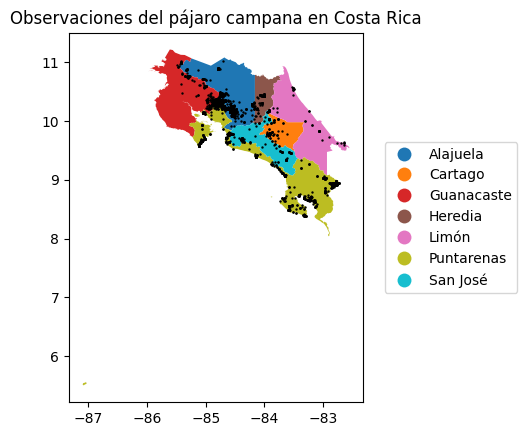

In [ ]:
#Graficar las observaciones de la especie en Costa Rica
fig, ax = plt.subplots()
cr_mapa.plot(ax=ax, column="provincia",
            legend=True,
            legend_kwds={"loc": "center right", "bbox_to_anchor": (1.55, .5)},
            figsize=(7, 7)
           )
ax.set_title('Observaciones del pájaro campana en Costa Rica')
obvs_gdf.plot(ax=ax, marker='o', color='black', markersize = 0.5)

# **Discusión**

El Pájaro Campana es una especie bandera en ciertos sitios de Costa Rica, tales como el Corredor Biológico Pájaro Campana y el Corredor Biológico Amistosa, pues durante su migración anual ambos corredores resultan ser fundamentales para sustentar sus movimientos. A su vez, la especies es un gran dispersor de semillas, muy importante en la dinámica de los bosques y sus hábitats, incluyendo el bosque nuboso, ya que regurgitan las semillas desde sus perchas ubicadas generalmente en claros del bosque, sonde las semillas tienen mucho éxito en la germinación.

De hecho, se puede ver en los mapas que la mayor cantidad de observaciones del pájaro campana se dan en las provincias de Puntarenas, seguido por Alajuela y Guanacaste. El resto de las provincias muestra observaciones esporádicas de la especie.

Esto coindice con el conocimiento de que la especie presenta dos dialectos de vocalización, uno típico del área de Monteverde y otro de la zona sur, específicamente el Corredor Biológico Amistosa y áreas protegidas colindantes, fundamentalmente Zona Protectora las Tablas, donde se reproduce.

Este trabajo permite conocer la distribución de la especie en Costa Rica, las zonas donde ocurre con mayor frecuencia, información que puede ser útil como base para investigaciones específicas y para la toma decisiones de conservación por las entidades encargadas de tales funciones.

#**Bibliografía**


*   BirdLife International (2021) (https://datazone.birdlife.org/2021-annual-update)
*   Brant, A. S., M. R. Emberling, C. E. Scott, and M. T. Davie (2020). Three-wattled Bellbird (Procnias tricarunculatus), version 1.0. In Birds of the World (S. M. Billerman, B. K. Keeney, P. G. Rodewald, and T. S. Schulenberg, Editors). Cornell Lab of Ornithology, Ithaca, NY, USA. https://doi.org/10.2173/bow.thwbel.01 de la lista
*   GADM (https://gadm.org/data.html)
*   GBIF (https://www.gbif.org/)
*   Powell, G. V., & Bjork, R. D. (2004). Habitat linkages and the conservation of tropical biodiversity as indicated by seasonal migrations of Three-wattled Bellbirds. Conservation Biology, 18(2), 500-509. de la lista




